# Advanced Lane Line Finding

## Overview

This project is to recognize the lanes from the video taken from the camera attached to the front of the car.
Videos and images used in this project are all from Udacity.
The raw data can be found from https://github.com/udacity/CarND-Advanced-Lane-Lines
Below is the summary of steps taken in this project:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## Step 1: Camera calibration 

Chessboard corner detection failed for ./camera_cal/calibration1.jpg
Chessboard corner detection works for ./camera_cal/calibration10.jpg
Chessboard corner detection works for ./camera_cal/calibration11.jpg
Chessboard corner detection works for ./camera_cal/calibration12.jpg
Chessboard corner detection works for ./camera_cal/calibration13.jpg
Chessboard corner detection works for ./camera_cal/calibration14.jpg
Chessboard corner detection works for ./camera_cal/calibration15.jpg
Chessboard corner detection works for ./camera_cal/calibration16.jpg
Chessboard corner detection works for ./camera_cal/calibration17.jpg
Chessboard corner detection works for ./camera_cal/calibration18.jpg
Chessboard corner detection works for ./camera_cal/calibration19.jpg
Chessboard corner detection works for ./camera_cal/calibration2.jpg
Chessboard corner detection works for ./camera_cal/calibration20.jpg
Chessboard corner detection works for ./camera_cal/calibration3.jpg
Chessboard corner detection failed f

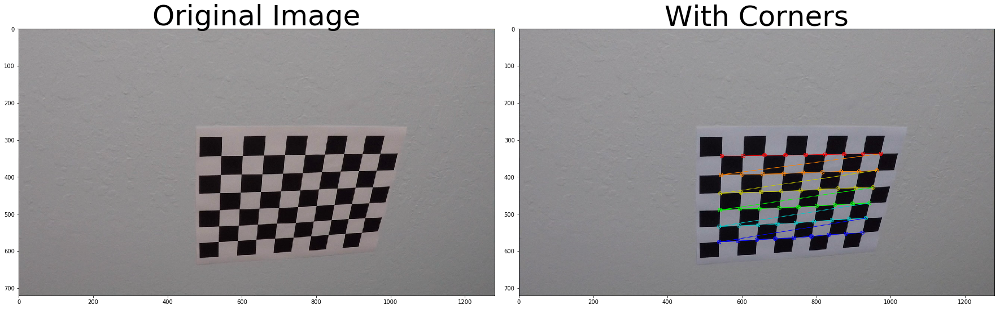

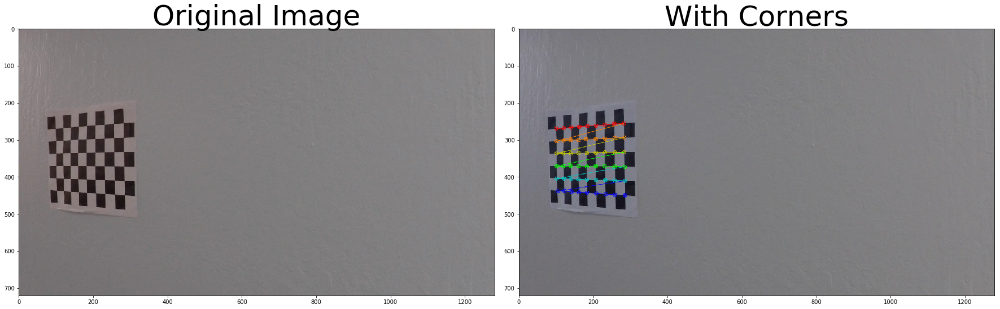

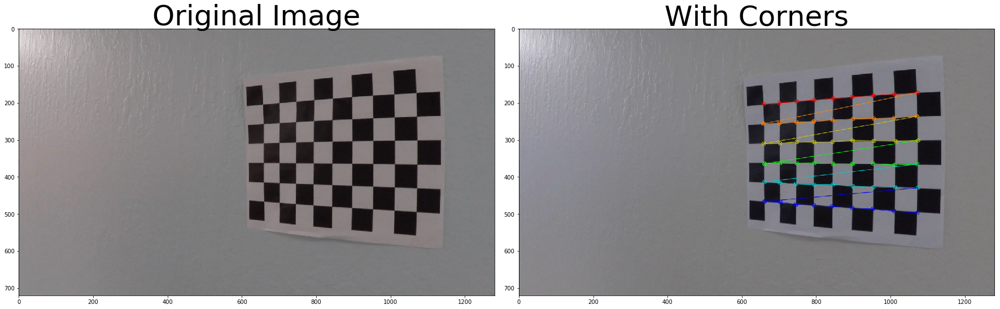

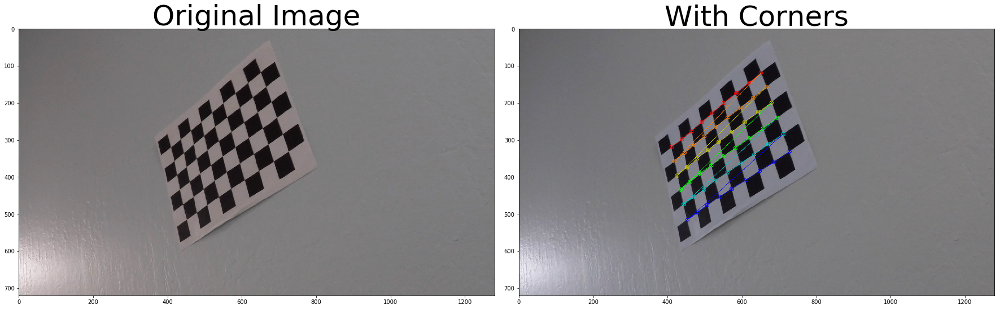

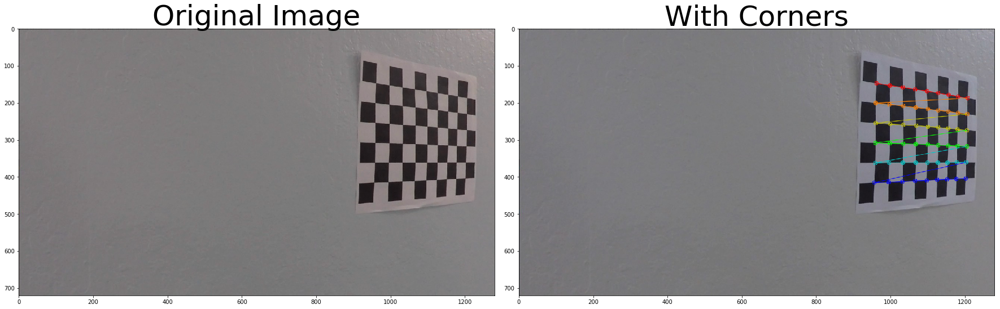

...

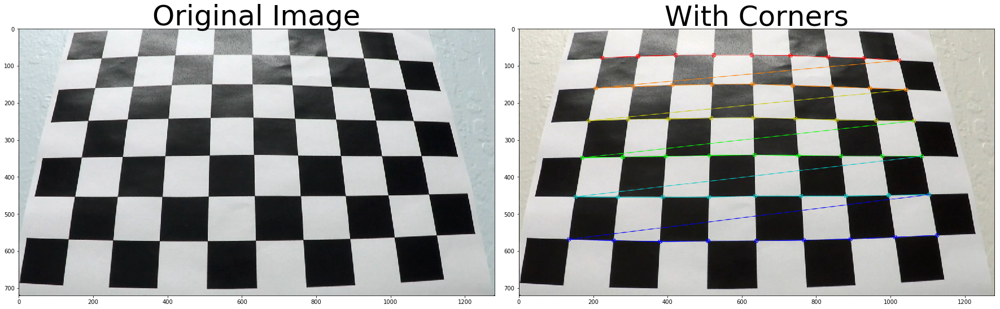

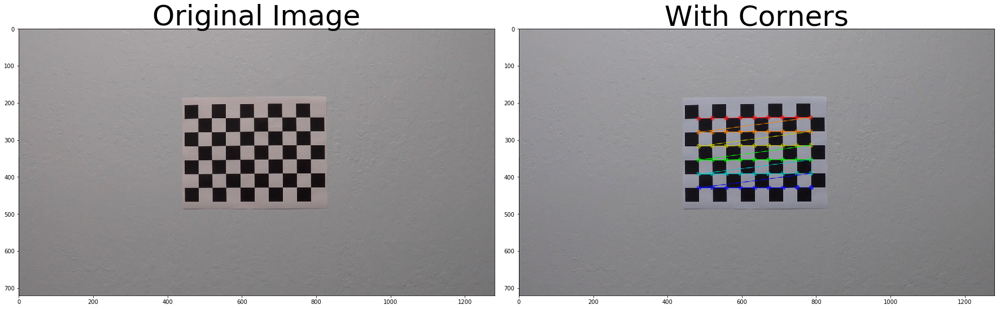

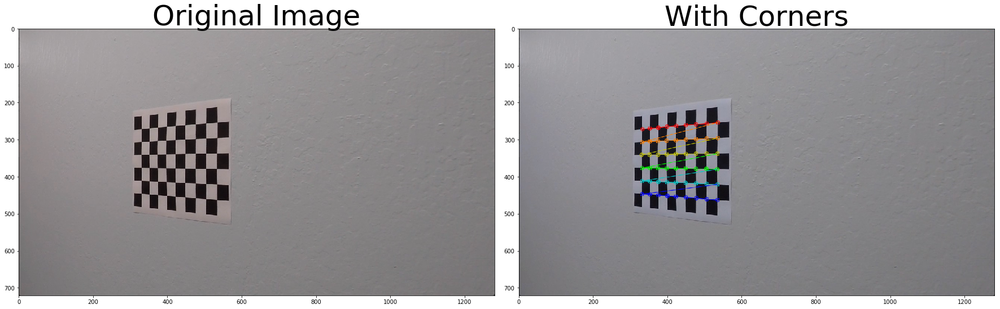

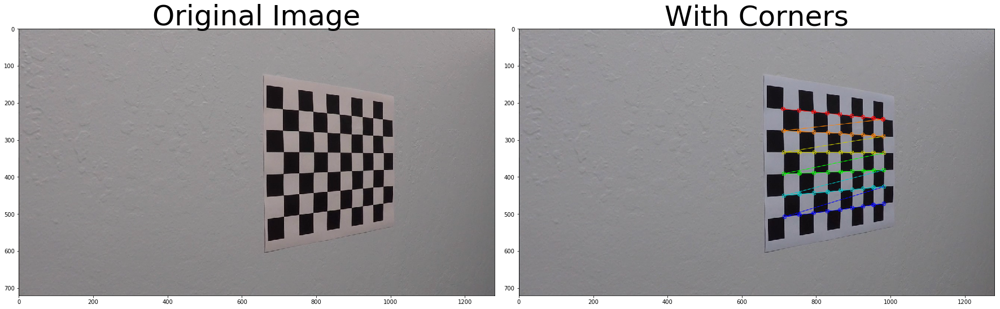

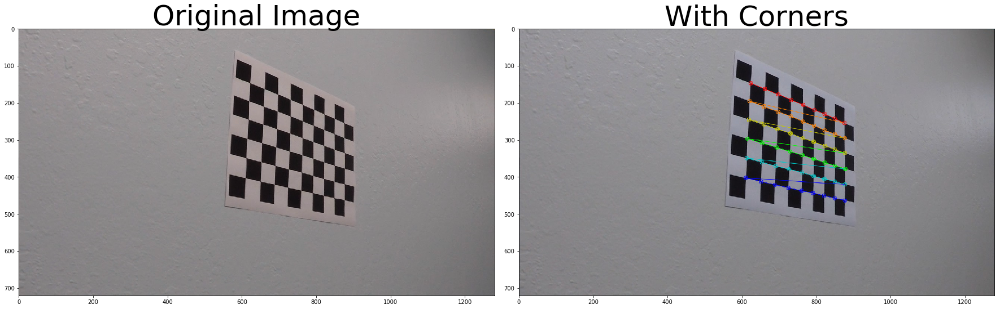

In [1]:
import glob
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
nx = 9
ny = 6
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:        
        objpoints.append(objp)
        imgpoints.append(corners)
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
        f.tight_layout()
        ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax2.set_title('With Corners', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        print('Chessboard corner detection works for', fname)

    else :
        print('Chessboard corner detection failed for', fname)

## Step 2 : Apply distortion correction

In [2]:
# Remove distortion from images
def undistort(img, show=True):

    img_size = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    if show:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
        f.tight_layout()
        ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    else:
        return undist

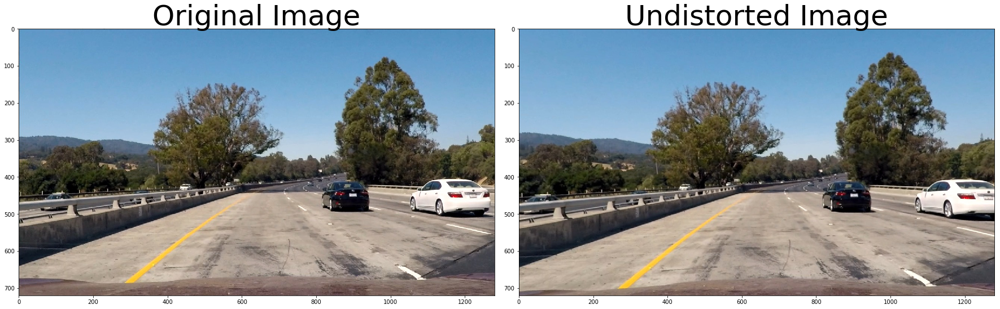

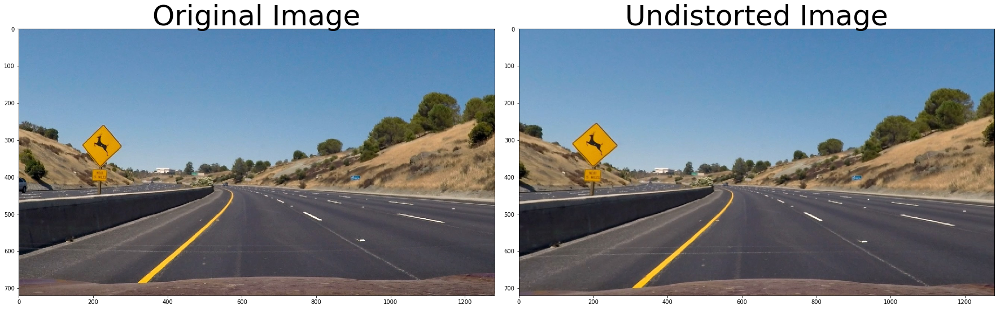

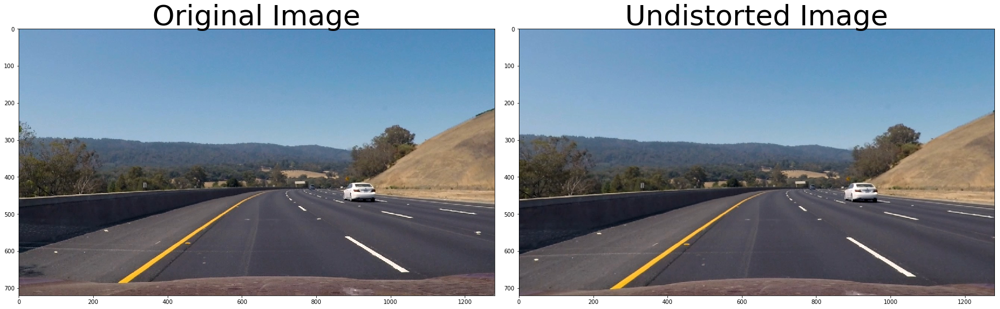

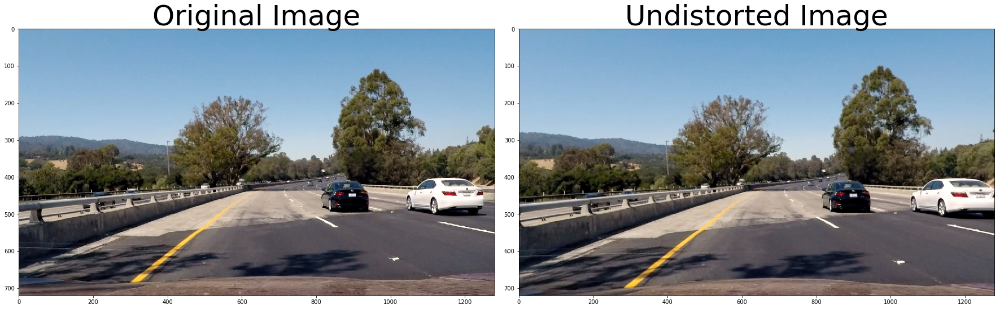

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


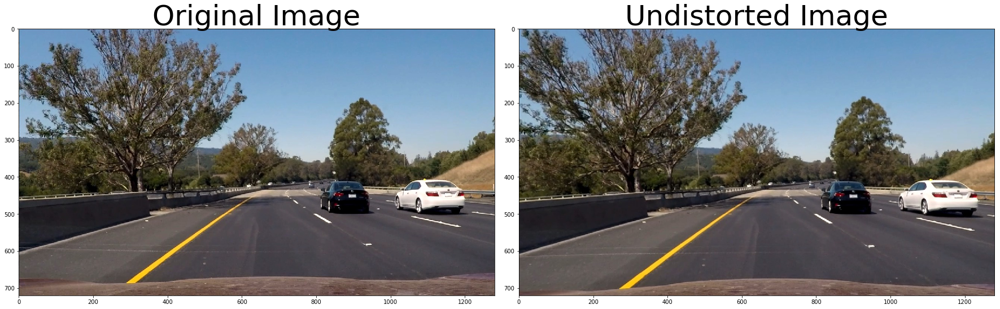

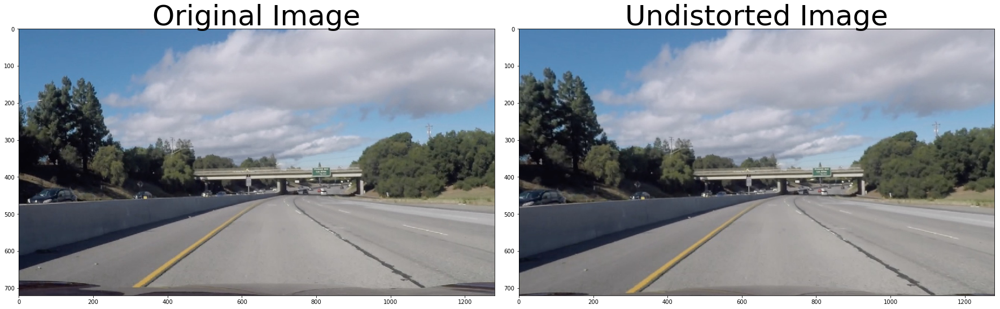

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


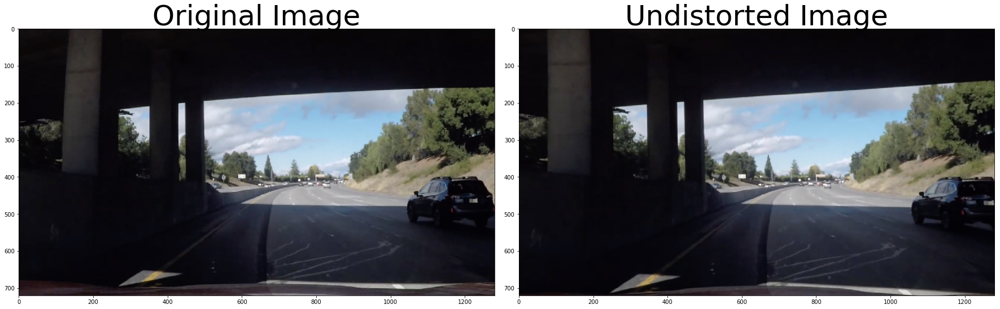

In [3]:
images = glob.glob('test_images/test*.jpg')
for fname in images:
    img = cv2.imread(fname)
    undistort(img)

## Step 3: Perspective transformation

In [4]:
import math

# Perform perspective transform
def birds_eye(img, display=True):
  
    undist = undistort(img, show = False) 
        
    img_size = (undist.shape[1], undist.shape[0])
    image_width = img_size[0]
    image_height = img_size[1]
    
    src = np.float32([[530, 480],[760, 480],
                      [1250, 720],[100, 720]])
#     dst = np.float32([[0, 0], [1280, 0], 
#                      [1250, 720],[100, 720]])
    
#     cv2.line(undist,(100, 720), (530, 480), (255, 0, 0),thickness=2)
#     cv2.line(undist,(1250, 720), (760, 480), (255, 0, 0),thickness=2)
    
    # Destination coordinates
    offset_tb = 0
    offset_lr = 100
    dst = np.float32([[offset_lr, offset_tb], [img_size[0] - offset_lr, offset_tb],
                            [img_size[0] - offset_lr, img_size[1]-offset_tb], [offset_lr, img_size[1]-offset_tb]])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)

    warped = cv2.warpPerspective(undist, M, img_size)
        
    if display:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
        ax1.set_title('Before Transformation', fontsize=50)
        ax2.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
        ax2.set_title('After Transformation', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    else:
        return warped, M

Test with straight lines

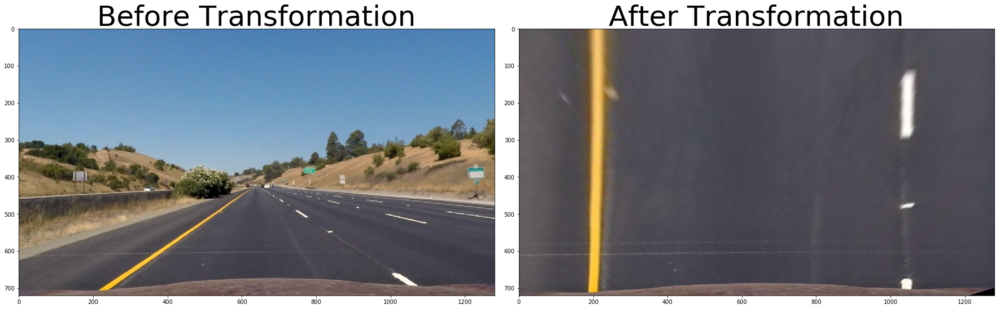

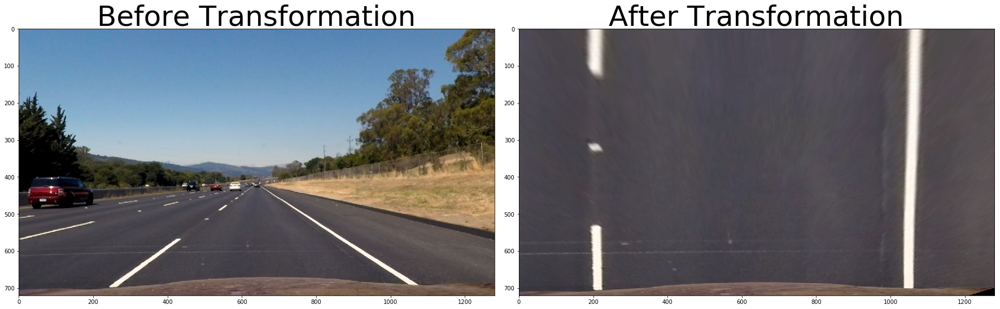

In [5]:
images = glob.glob('test_images/straight_lines*.jpg')
for fname in images:
    img = cv2.imread(fname)
    birds_eye(img)

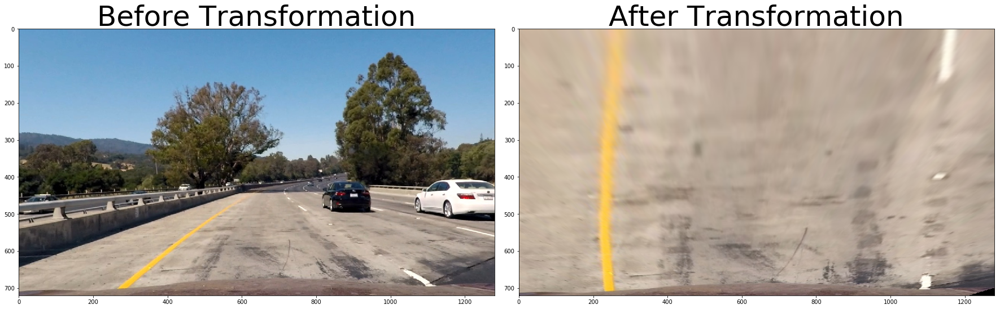

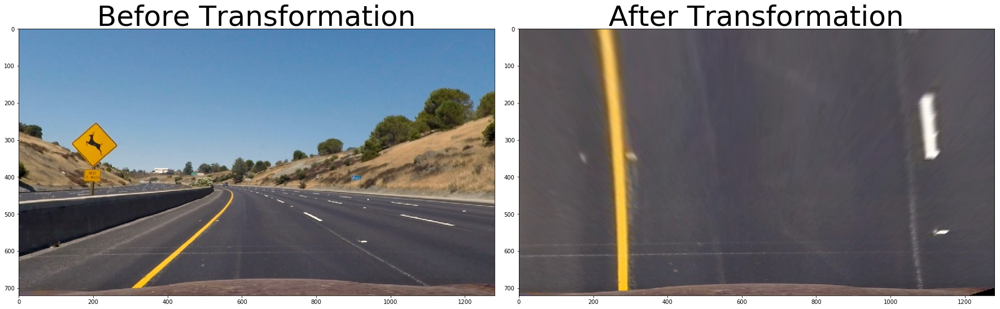

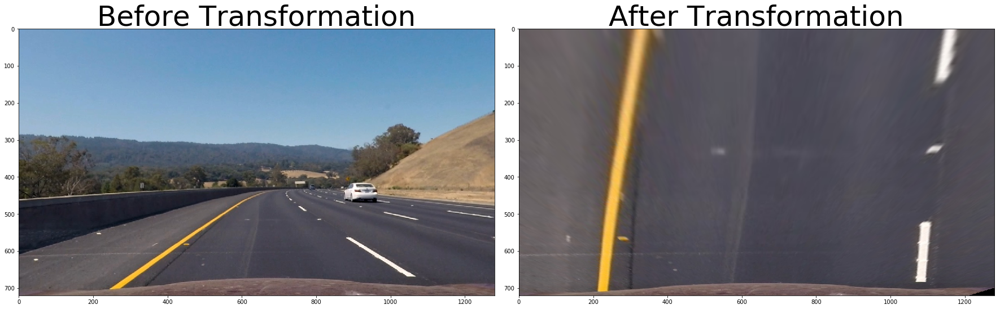

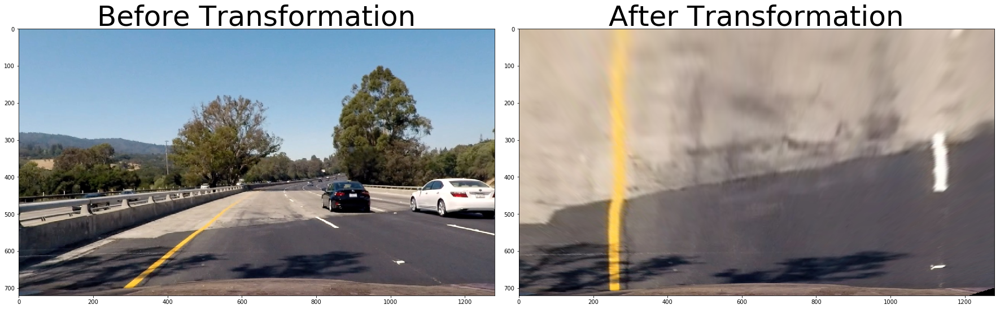

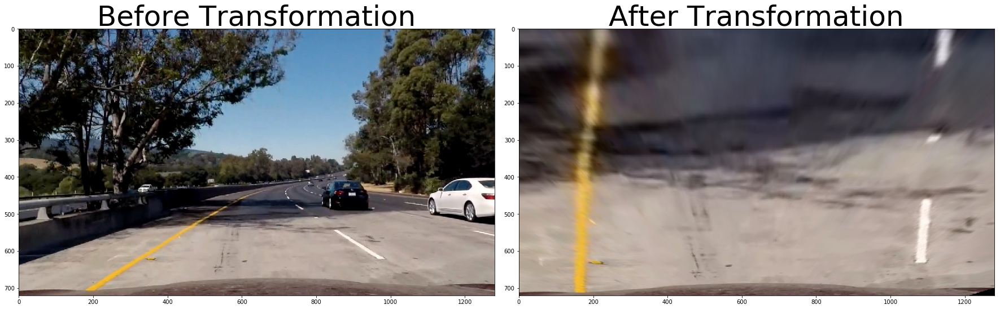

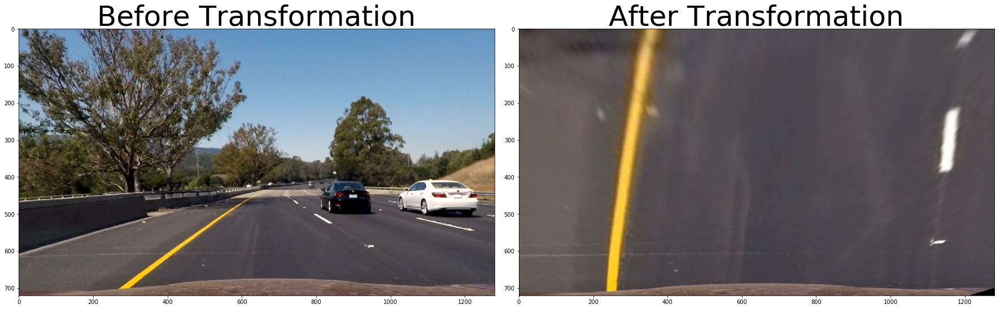

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


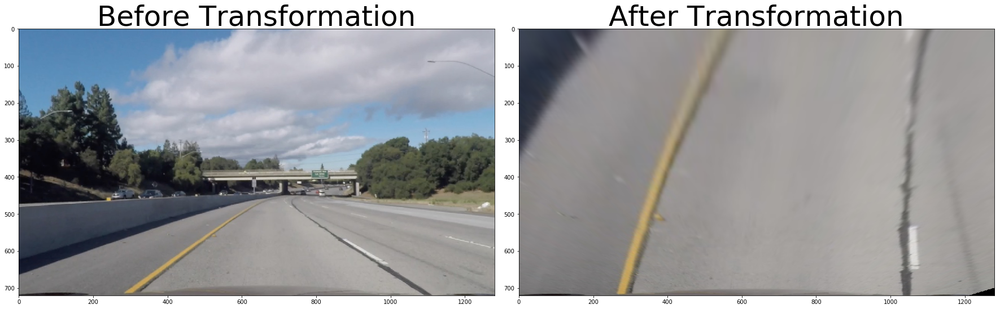

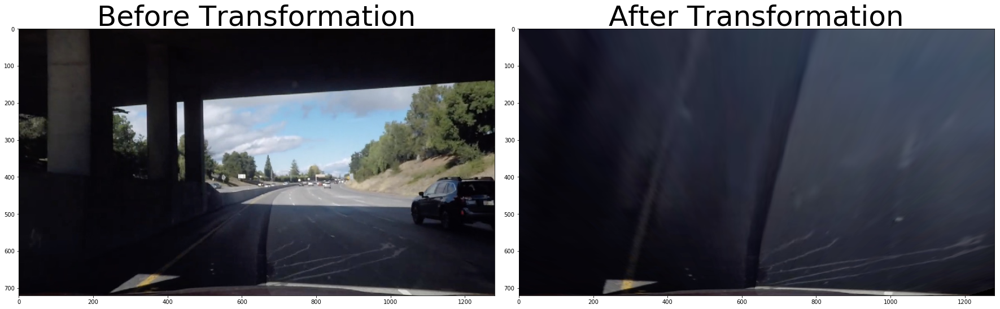

In [6]:
## perform perspective transformation on test images
images = glob.glob('test_images/test*.jpg')
for fname in images:
    img = cv2.imread(fname)
    birds_eye(img)

## Step 4: Create thresholded binary image

Helper functions to create binary threshold 

In [7]:
# All input images have to be undistorted
def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    # 3) Take the absolute value of the derivative or gradient
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel))
  
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    grad_binary = np.zeros_like(scaled_sobel)  
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
   # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # 3) Calculate the magnitude 
    sobelmag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    gradmag = np.uint8(255 * sobelmag/np.max(sobelmag))
    # 5) Create a binary mask where mag thresholds are met
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
   # 1) Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)

    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    sobel_dir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    # 5) Create a binary mask where direction thresholds are met
    dir_binary = np.zeros_like(sobel_dir)
    # 6) Return this mask as your binary_output image
    dir_binary[(sobel_dir >= thresh[0]) & (sobel_dir <= thresh[1])] = 1
    return dir_binary

def s_threshold(image, s_thresh=(0, 255)):
    # 1) Convert to HLS and and separate the S channel
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    return s_binary

def h_threshold(image, h_thresh=(0, 255)):
    # 1) Convert to HLS and and separate the l channel
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    return h_binary

def l_threshold(image, l_thresh=(0, 255)):
    # 1) Convert to HLS and and separate the l channel
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    return l_binary

def b_threshold(image, b_thresh=(0, 255)):
    # 1) Convert to HLS and and separate the S channel
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2Lab)
    b_channel = lab[:,:,2]
    
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    return b_binary

def white_threshold(image, w_thresh=(0, 255)):
    # 1) Convert to HLS and and separate the S channel
    r_channel = image[:,:,0]
    g_channel = image[:,:,1]
    b_channel = image[:,:,2]

    w_binary = np.zeros_like(r_channel)
    w_binary[(r_channel >= w_thresh[0]) & (g_channel >= w_thresh[0]) & (b_channel >= w_thresh[0]) 
            &(r_channel <= w_thresh[1]) & (g_channel <= w_thresh[1]) & (b_channel <= w_thresh[1])] = 1
    return w_binary

def yellow_threshold(image, y_thresh=(0, 255)):
    
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_yellow = np.array([y_thresh[0],100,100])
    upper_yellow = np.array([y_thresh[1],255,255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    yellow_image = cv2.bitwise_and(image, image, mask=yellow_mask)
    gray = cv2.cvtColor(yellow_image, cv2.COLOR_RGB2GRAY)
    y_binary = np.zeros_like(gray)
    y_binary[gray != 0] = 1
    return y_binary

In [10]:
def apply_thresholds(image, show=True):
    
    img, M = birds_eye(image, display = False)


    # Apply each of the thresholding functions
    x_binary = abs_sobel_thresh(img, orient='x', sobel_kernel= 7, thresh=(30, 200))
#     y_binary = abs_sobel_thresh(img, orient='y', sobel_kernel= 7, thresh=(15, 100))
#     mag_binary = mag_thresh(img, sobel_kernel=5, mag_thresh=(80, 150))
#     dir_binary = dir_threshold(undist, sobel_kernel = 5, thresh=(0.7, 1.3))
    s_binary = s_threshold(img, s_thresh = (100, 255))
    y_binary = yellow_threshold(img, y_thresh = (20, 150))
    w_binary = white_threshold(img, w_thresh = (190, 255))
    b_binary = b_threshold(img, b_thresh = (5, 105))
    l_binary = l_threshold(img, l_thresh = (225, 255))
    h_binary = h_threshold(img, h_thresh = (20, 90))


    combined_all = np.zeros_like(s_binary)
    combined_all[((y_binary == 1) | (w_binary == 1) | (b_binary == 1))] = 1

#     if show == True:
#         # Plotting thresholded images
#         f, ((ax1, ax2, ax3)) = plt.subplots(1, 3, sharey='col', sharex='row', figsize=(20,4))
#         f.tight_layout()
        
#         ax1.set_title('original image', fontsize=30)
#         ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        
#         ax2.set_title('birds eye view', fontsize=30)
#         ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
#         ax3.set_title('combined threshold', fontsize=30)
#         ax3.imshow(combined_all, cmap='gray')
        
    if show == True:
        # Plotting thresholded images
        f, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(3, 3, sharey='col', sharex='row', figsize=(20, 10))
        f.tight_layout()
        
        ax1.set_title('b threshold', fontsize=16)
        ax1.imshow(b_binary, cmap = 'gray')
        
        ax2.set_title('x threshold', fontsize=16)
        ax2.imshow(x_binary, cmap = 'gray')
        
        ax3.set_title('l-color threshold', fontsize=16)
        ax3.imshow(l_binary, cmap='gray')
        
        ax4.set_title('y-color threshold', fontsize=16)
        ax4.imshow(y_binary, cmap='gray')
        
        ax5.set_title('h-color threshold', fontsize=16)
        ax5.imshow(h_binary, cmap='gray')
        
        ax6.set_title('w-color threshold', fontsize=16)
        ax6.imshow(w_binary, cmap='gray')
        
        ax7.set_title('original image', fontsize=20)
        ax7.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        
        ax8.set_title('undistorted', fontsize=20)
        ax8.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        ax9.set_title('combined threshold', fontsize=20)
        ax9.imshow(combined_all, cmap='gray')
        
    else: 
        return combined_all

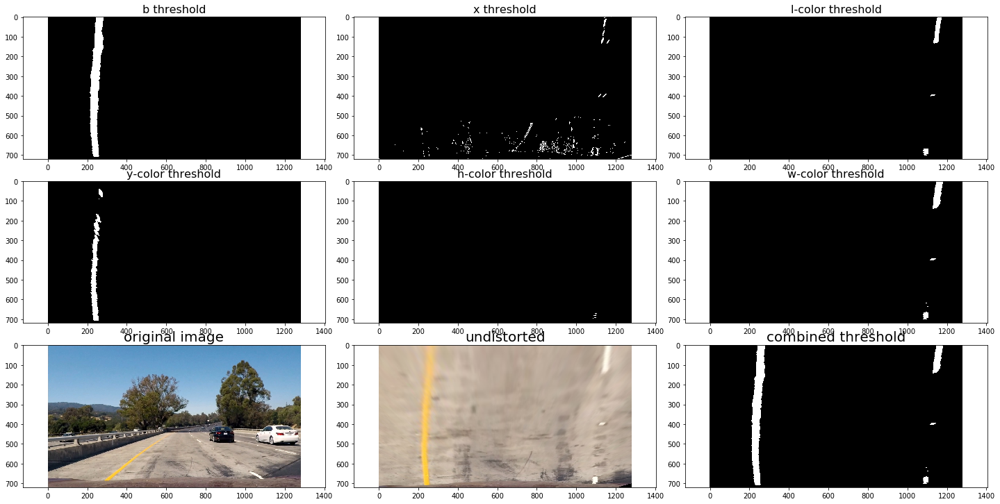

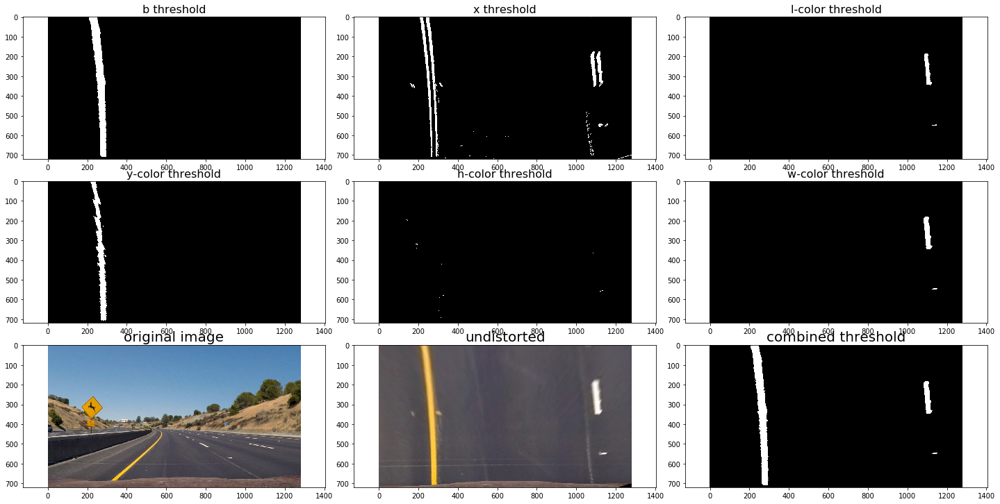

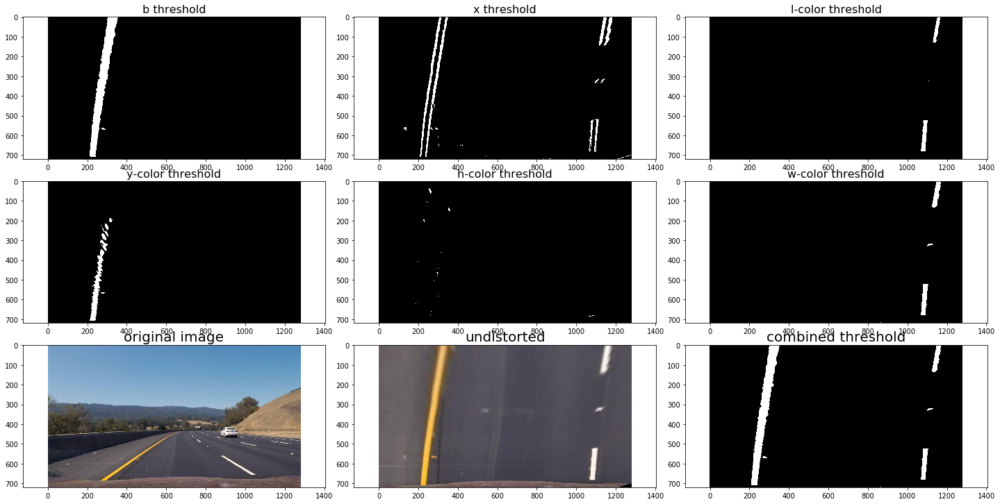

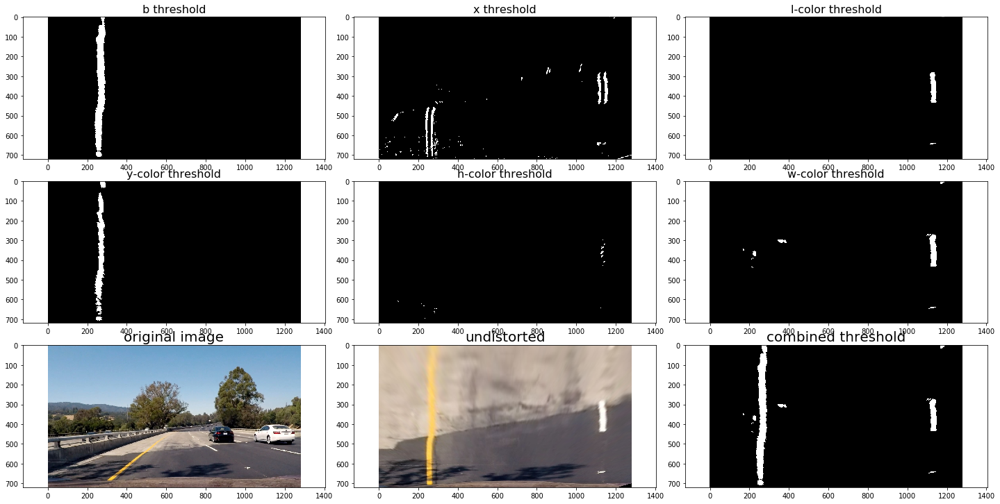

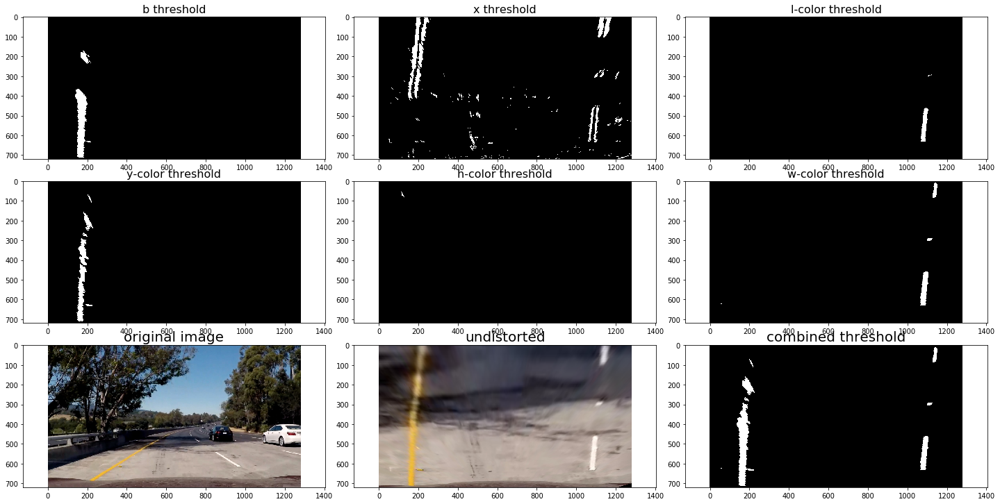

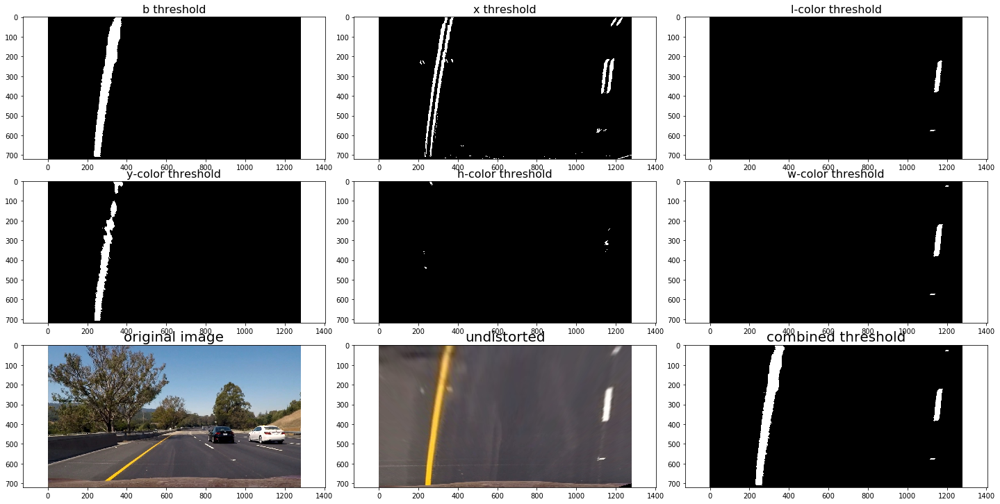

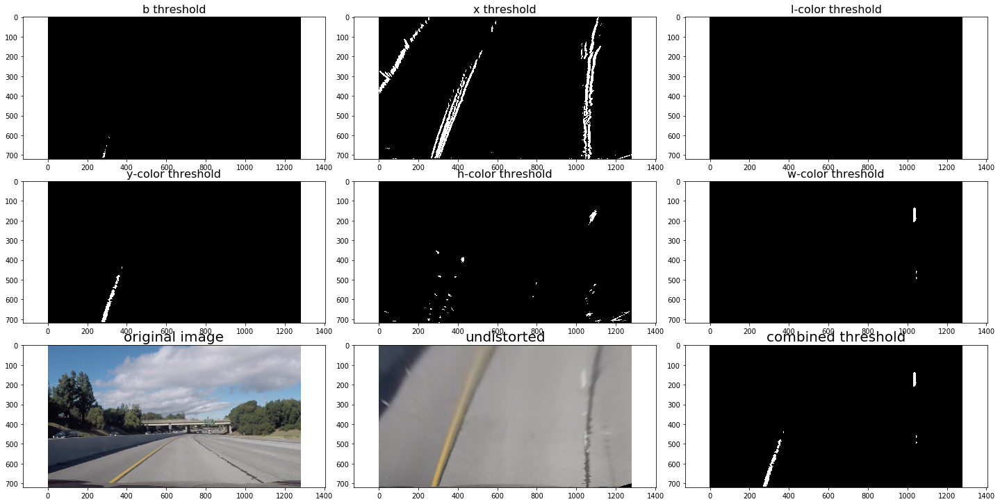

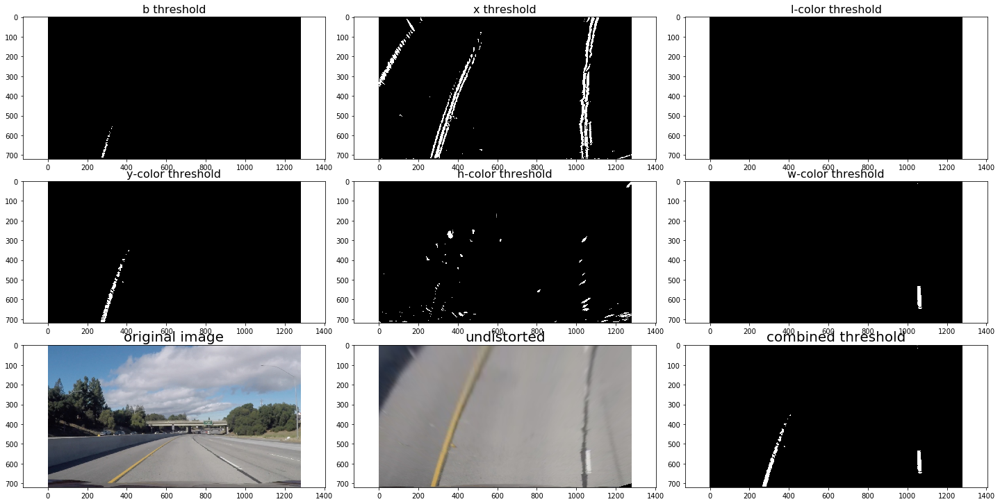

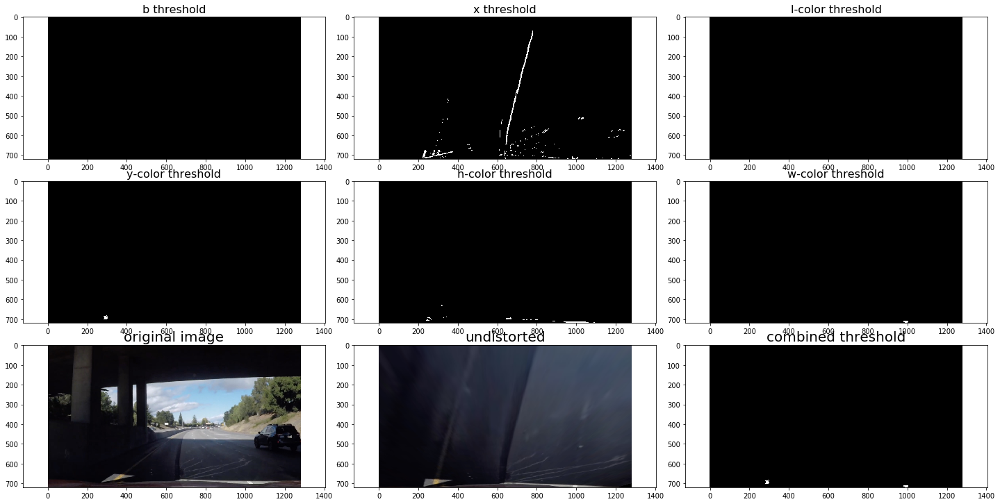

In [11]:
images = glob.glob('test_images/test*.jpg')
for fname in images:
    img = cv2.imread(fname)
    apply_thresholds(img)

## Step 5 through 8 : Find the lane boundary and output the visual display

some helper functions

In [12]:
# Take a histogram of the bottom half of the image
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
def find_initial_peaks(combined_binary, bottom_pct=0.5):
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(combined_binary[int(combined_binary.shape[0]/2):,:], axis=0)
    
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Return x-position of the two peaks
    return leftx_base, rightx_base

In [13]:
# Apply the sliding window to identify lane pixels, and fits a polynomial.
def sliding_window_poly(combined_binary, leftx_base, rightx_base, nwindows=10, minpix = 50, margin = 100):
    # nwindows: the number of sliding windows
    # minpix: minimum number of pixels found to recenter window
    # margin: width of the windows +/- margin
    rightx = []
    righty = []
    leftx = []
    lefty = []
    
    # Set height of windows
    window_height = np.int(combined_binary.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = combined_binary.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = combined_binary.shape[0] - (window+1)*window_height
        win_y_high = combined_binary.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
        
    # Fit a second order polynomial to each
    if len(leftx) > 0 and len(lefty) > 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit = None
        
    if len(rightx) > 0 and len(righty) > 0:    
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = None
        
    return left_fit, right_fit

In [14]:
# Calculate the lane line curvature
def get_curvature(poly, combined_binary):
    ym_per_pix = 30./720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    
    # Convert polynomial to set of points for refitting
    ploty = np.linspace(0, combined_binary.shape[0]-1, combined_binary.shape[0])
    fitx = poly[0] * ploty ** 2 + poly[1] * ploty + poly[2]
    
    # Fit new polynomial
    fit_cr = np.polyfit(ploty * ym_per_pix, fitx * xm_per_pix, 2)
    
    # Calculate curve radius
    curverad = ((1 + (2 * fit_cr[0] * np.max(ploty) * ym_per_pix + fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * fit_cr[0])
    return curverad

In [15]:
# Find the offset of the car and the base of the lane lines
def find_offset(left_fit, right_fit):
    lane_width = 3.7  # metres
    
    h = 720  # height of image 
    w = 1280 # width of image
    
    # Find the bottom pixel of the lane lines
    left_px = left_fit[0] * h ** 2 + left_fit[1] * h + left_fit[2]
    right_px = right_fit[0] * h ** 2 + right_fit[1] * h + right_fit[2]
    
    # Find the number of pixels per real metre
    scale = lane_width / np.abs(left_px - right_px)
    
    # Find the midpoint
    midpoint = np.mean([left_px, right_px])
    
    # Find the offset from the centre of the frame, and then multiply by scale
    offset = (w/2 - midpoint) * scale
    return offset

In [16]:
# lane detection
def find_lane(image):
#     img = mpimg.imread(image)
    combined_binary = apply_thresholds(image, show=False)
    
    # Keep the untransformed image for later
    original = image.copy()

    
    # Find initial histogram peaks
    leftx_base, rightx_base = find_initial_peaks(combined_binary)
    # Get the sliding window polynomials for each line line
    left_fit, right_fit = sliding_window_poly(combined_binary, leftx_base, rightx_base, nwindows=9, minpix = 50, margin = 100)
    
        
    # Calculate the lane curvature radius
    left_rad = get_curvature(left_fit, combined_binary)
    right_rad = get_curvature(right_fit, combined_binary)
    
    # Get mean of curvatures
    rad = np.mean([left_rad, right_rad])
        
    # Create image
    img_size = (image.shape[1], image.shape[0])

    src = np.float32([[530, 480],[760, 480],
                      [1250, 720],[100, 720]])

    offset_tb = 0
    offset_lr = 100
    dst = np.float32([[offset_lr, offset_tb], [img_size[0] - offset_lr, offset_tb],
                            [img_size[0] - offset_lr, img_size[1]-offset_tb], [offset_lr, img_size[1]-offset_tb]])

    Minv = cv2.getPerspectiveTransform(dst, src)
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero = np.zeros_like(combined_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    pts_left = np.array([np.flipud(np.transpose(np.vstack([left_fitx, ploty])))])
    pts_right = np.array([np.transpose(np.vstack([right_fitx, ploty]))])
    pts = np.hstack((pts_left, pts_right))
    
    cv2.polylines(color_warp, np.int_([pts]), isClosed=False, color=(0,0,255), thickness = 40)
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    newwarp = cv2.warpPerspective(color_warp, Minv, (combined_binary.shape[1], combined_binary.shape[0]))
    
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    offset = find_offset(left_fit, right_fit)


    f, (ax1, ax2) = plt.subplots(1,2, figsize=(9, 6))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor((birds_eye(image, display=False)[0]), cv2.COLOR_BGR2RGB))
    ax1.set_xlim(0, 1280)
    ax1.set_ylim(0, 720)
    ax1.plot(left_fitx, ploty, color='green', linewidth=3)
    ax1.plot(right_fitx, ploty, color='green', linewidth=3)
    ax1.set_title('Fit Polynomial to Lane Lines', fontsize=16)
    ax1.invert_yaxis() # to visualize as we do the images
    
    ax2.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    ax2.set_title('Fill Lane Between Polynomials', fontsize=16)
    if offset >= 0:
        ax2.text(200, 100, 'Vehicle is {:.2f}m left of center'.format(offset),
                 style='italic', color='white', fontsize=10)
    else:
        ax2.text(200, 100, 'Vehicle is {:.2f}m right of center'.format(-offset),
                 style='italic', color='white', fontsize=10)
    
    ax2.text(200, 175, 'Radius of curvature is {:.2f}km'.format(rad/1000),
             style='italic', color='white', fontsize=10)
    
    return result


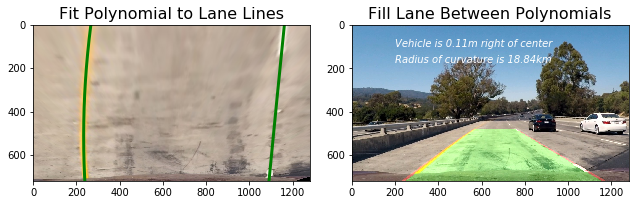

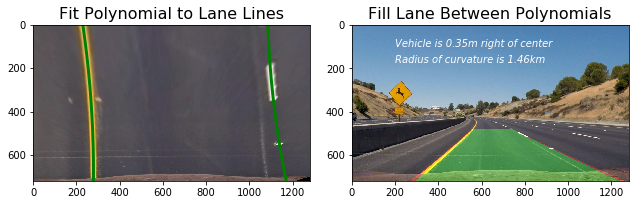

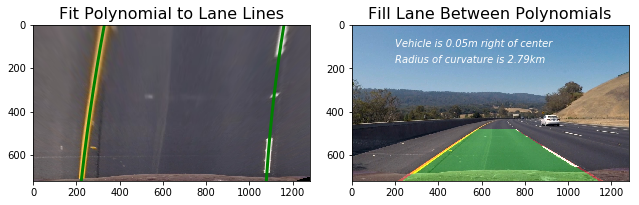

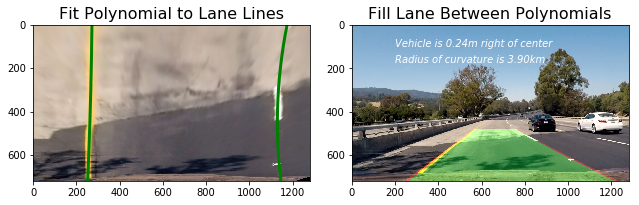

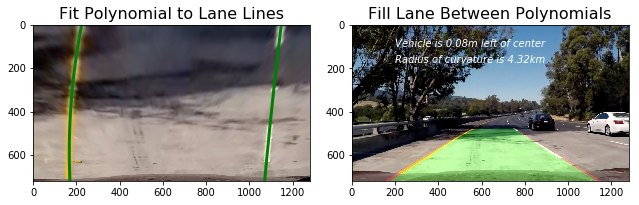

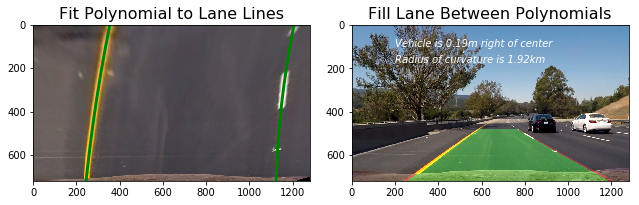

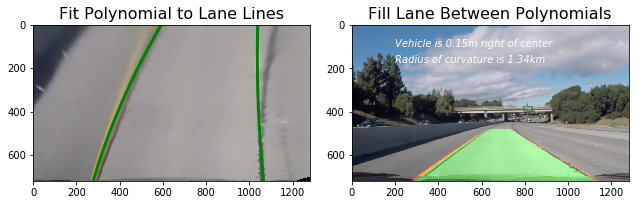

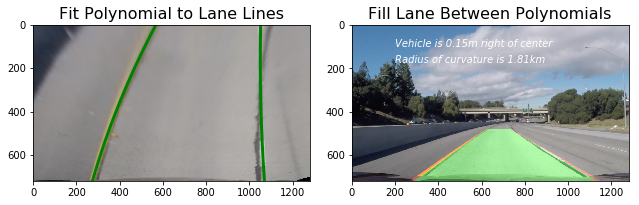

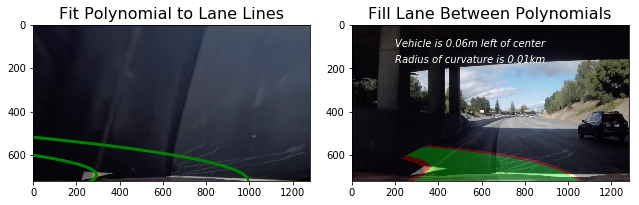

In [17]:
images = glob.glob('test_images/test*.jpg')
for fname in images:
    img = cv2.imread(fname)
    find_lane(img)

## Test on Videos

We can test our pipeline on three provided videos:

`project_video.mp4`

`challenge_video.mp4`

`harder_challenge_video.mp4`


In [20]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [181]:
# Assume you now have a new warped binary image 
# from the next frame of video (also called "combined_binary")
# Apply the sliding window to identify lane pixels, and fits a polynomial.
def sliding_window_update(combined_binary, left_fit, right_fit, margin = 100):
    nonzero = combined_binary.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    if len(leftx) > 0 and len(lefty) > 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit = None
        
    if len(rightx) > 0 and len(righty) > 0:    
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = None
        

    return left_fit, right_fit

In [206]:
def is_good_fit(left_fit, right_fit, threshold = [650, 750]):
    Flag = False 
    if left_fit is not None and right_fit is not None:
        left_fitx_top = left_fit[0]*0**2 + left_fit[1]*0 + left_fit[2]
        right_fitx_top = right_fit[0]*0**2 + right_fit[1]*0 + right_fit[2]
        left_fitx_bot = left_fit[0]*720**2 + left_fit[1]*720 + left_fit[2]
        right_fitx_bot = right_fit[0]*720**2 + right_fit[1]*720 + right_fit[2]
        mean_width = np.mean(np.array([left_fitx_top, left_fitx_bot, right_fitx_bot, right_fitx_top])) 
            
        if mean_width > threshold[0] and mean_width < threshold[1]:
            Flag = True
            
    return Flag

In [207]:
# pipeline for ane detection
# Buffer for retaining curvature and polygon information between frames
last_rad = None
left_fit_hist=None
right_fit_hist=None
avg_left_fit = None
avg_right_fit = None

def process_frame(image):
    
    global last_rad, left_fit_hist, right_fit_hist, avg_left_fit, avg_right_fit
    
    
    #img = mpimg.imread(image)
    combined_binary = apply_thresholds(image, show=False)
    
    # Keep the untransformed image for later
    original = image.copy()

    # Define weights for smoothing
    rad_alpha = 0.05
    poly_alpha_g = 0.5
    poly_alpha_b = 0.1
    
    # of frames to average
    N = 10
    
#     # If first frame, initialize buffer
#     if left_fit_hist is None : 
    # Find initial histogram peaks
    leftx_base, rightx_base = find_initial_peaks(combined_binary)
    left_fit, right_fit = sliding_window_poly(combined_binary, leftx_base, rightx_base, nwindows=9, minpix = 50, margin = 100)
#     else: 
#         # use previous fits to predict the position of laneline on new frame
#         left_fit, right_fit = sliding_window_update(combined_binary, avg_left_fit, avg_right_fit, margin = 100)
    
    # If first frame, initialise buffer
    if left_fit_hist is None:
        
        left_fit_hist=[]
        left_fit_hist.append(left_fit)
        right_fit_hist=[]
        right_fit_hist.append(right_fit)
        
        avg_left_fit = np.mean(np.array(left_fit_hist), axis = 0)
        avg_right_fit = np.mean(np.array(right_fit_hist), axis = 0)

    else:
        # Otherwise, if it's a bad frame, update with smoothing of the past N moving averages
        if left_fit is None:
            left_fit = avg_left_fit 
            
        if right_fit is None: 
            right_fit = avg_right_fit 
            
        if not is_good_fit(left_fit, right_fit, threshold = [650, 750]) or ((abs(right_fit - avg_right_fit) / avg_right_fit ) > np.array([0.2,0.2,0.2])).all() or ((abs(left_fit - avg_left_fit) / avg_left_fit ) > np.array([0.2,0.2,0.2])).all():
            left_fit = avg_left_fit 
            right_fit = avg_right_fit 
        
        else: 
        
            left_fit = (1 - poly_alpha_g) * avg_left_fit + poly_alpha_g * left_fit
                
            if len(left_fit_hist) > N:
                left_fit_hist = left_fit_hist[1:]
                    
            left_fit_hist.append(left_fit)
            avg_left_fit = np.mean(np.array(left_fit_hist), axis = 0) 
          
            right_fit = (1 - poly_alpha_g) * avg_right_fit + poly_alpha_g * right_fit
                
            if len(right_fit_hist) > N:
                
                right_fit_hist = right_fit_hist[1:]
                    
            right_fit_hist.append(right_fit)
            avg_right_fit = np.mean(np.array(right_fit_hist), axis = 0)             
                
    # Calculate the lane curvature radius
    left_rad = get_curvature(left_fit, combined_binary)
    right_rad = get_curvature(right_fit, combined_binary)
    
    # Get mean of curvatures
    rad = np.mean([left_rad, right_rad])
    
    # Update curvature using weighted average with last frame
    if last_rad is None:
        last_rad = rad
    else:
        rad = (1 - rad_alpha) * last_rad + rad_alpha * rad 
    
    # Create image
    img_size = (image.shape[1], image.shape[0])

    src = np.float32([[530, 480],[760, 480],
                      [1250, 720],[100, 720]])

    offset_tb = 0
    offset_lr = 100
    dst = np.float32([[offset_lr, offset_tb], [img_size[0] - offset_lr, offset_tb],
                            [img_size[0] - offset_lr, img_size[1]-offset_tb], [offset_lr, img_size[1]-offset_tb]])

    Minv = cv2.getPerspectiveTransform(dst, src)
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero = np.zeros_like(combined_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    pts_left = np.array([np.flipud(np.transpose(np.vstack([left_fitx, ploty])))])
    pts_right = np.array([np.transpose(np.vstack([right_fitx, ploty]))])
    pts = np.hstack((pts_left, pts_right))
    
    cv2.polylines(color_warp, np.int_([pts]), isClosed=False, color=(0,0,255), thickness = 40)
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    newwarp = cv2.warpPerspective(color_warp, Minv, (combined_binary.shape[1], combined_binary.shape[0]))
    
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    offset = find_offset(left_fit, right_fit)

    if offset >= 0:
         cv2.putText(result, 'Vehicle is {:.2f}m left of center'.format(offset), (100,80),
                 fontFace = 16, fontScale = 1, color=(255,255,255), thickness = 2)
    else:
        cv2.putText(result, 'Vehicle is {:.2f}m right of center'.format(-offset), (100,80),
                 fontFace = 16, fontScale = 1, color=(255,255,255), thickness = 2)
    # Print radius of curvature on video
    cv2.putText(result, 'Radius of Curvature {:.2f}(km)'.format(rad/1000), (120,140),
             fontFace = 16, fontScale = 1, color=(255,255,255), thickness = 2)
    
    return result

In [ ]:
white_output = 'test_videos_output/project_video.mp4'
clip1 = VideoFileClip("./project_video.mp4")
white_clip = clip1.fl_image(process_frame) #NOTE: this function expects color images
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video.mp4
[MoviePy] Writing video test_videos_output/project_video.mp4








  0%|          | 0/1261 [00:00<?, ?it/s]





  0%|          | 1/1261 [00:00<16:23,  1.28it/s]





  0%|          | 2/1261 [00:01<16:21,  1.28it/s]





  0%|          | 3/1261 [00:02<16:11,  1.29it/s]





  0%|          | 4/1261 [00:03<16:47,  1.25it/s]





  0%|          | 5/1261 [00:03<16:46,  1.25it/s]





  0%|          | 6/1261 [00:04<16:25,  1.27it/s]





  1%|          | 7/1261 [00:05<16:10,  1.29it/s]





  1%|          | 8/1261 [00:06<16:09,  1.29it/s]





  1%|          | 9/1261 [00:07<16:09,  1.29it/s]





  1%|          | 10/1261 [00:07<16:16,  1.28it/s]





  1%|          | 11/1261 [00:08<16:21,  1.27it/s]





  1%|          | 12/1261 [00:09<16:31,  1.26it/s]





  1%|          | 13/1261 [00:10<16:25,  1.27it/s]





  1%|          | 14/1261 [00:10<16:15,  1.28it/s]





  1%|          | 15/1261 [00:11<16:05,  1.29it/s]





  1%|▏         | 16/1261 [00:12<16:03,  1.29it/s]





  1%|▏         | 17/1261 [00:13<16:01,  1.29it/s]





  1%|▏         | 18/12

  9%|▉         | 112/1261 [01:27<14:31,  1.32it/s]





  9%|▉         | 113/1261 [01:27<14:44,  1.30it/s]





  9%|▉         | 114/1261 [01:28<14:40,  1.30it/s]





  9%|▉         | 115/1261 [01:29<14:38,  1.30it/s]





  9%|▉         | 116/1261 [01:30<14:38,  1.30it/s]





  9%|▉         | 117/1261 [01:30<14:36,  1.31it/s]





  9%|▉         | 118/1261 [01:31<14:31,  1.31it/s]





  9%|▉         | 119/1261 [01:32<14:28,  1.31it/s]





 10%|▉         | 120/1261 [01:33<14:37,  1.30it/s]





 10%|▉         | 121/1261 [01:33<14:37,  1.30it/s]





 10%|▉         | 122/1261 [01:34<14:38,  1.30it/s]





 10%|▉         | 123/1261 [01:35<14:37,  1.30it/s]





 10%|▉         | 124/1261 [01:36<14:29,  1.31it/s]





 10%|▉         | 125/1261 [01:37<14:29,  1.31it/s]





 10%|▉         | 126/1261 [01:37<14:28,  1.31it/s]





 10%|█         | 127/1261 [01:38<14:24,  1.31it/s]





 10%|█         | 128/1261 [01:39<14:31,  1.30it/s]





 10%|█         | 129/1261 [01:40<14:26,  1.31it/

In [209]:
challenge_output = 'test_videos_output/challenge_video.mp4'
clip1 = VideoFileClip("./challenge_video.mp4")
challenge_clip = clip1.fl_image(process_frame) #NOTE: this function expects color images
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/challenge_video.mp4
[MoviePy] Writing video test_videos_output/challenge_video.mp4








  0%|          | 0/485 [00:00<?, ?it/s]





  0%|          | 1/485 [00:00<06:06,  1.32it/s]





  0%|          | 2/485 [00:01<06:03,  1.33it/s]





  1%|          | 3/485 [00:02<06:09,  1.30it/s]





  1%|          | 4/485 [00:03<06:24,  1.25it/s]





  1%|          | 5/485 [00:04<06:29,  1.23it/s]





  1%|          | 6/485 [00:04<06:34,  1.21it/s]





  1%|▏         | 7/485 [00:05<06:33,  1.22it/s]





  2%|▏         | 8/485 [00:06<06:29,  1.23it/s]





  2%|▏         | 9/485 [00:07<06:37,  1.20it/s]





  2%|▏         | 10/485 [00:08<06:27,  1.22it/s]





  2%|▏         | 11/485 [00:08<06:16,  1.26it/s]





  2%|▏         | 12/485 [00:09<06:07,  1.29it/s]





  3%|▎         | 13/485 [00:10<06:00,  1.31it/s]





  3%|▎         | 14/485 [00:11<06:00,  1.30it/s]





  3%|▎         | 15/485 [00:11<06:00,  1.30it/s]





  3%|▎         | 16/485 [00:12<06:01,  1.30it/s]





  4%|▎         | 17/485 [00:13<05:58,  1.31it/s]





  4%|▎         | 18/485 [00:14<05:53,  1

 23%|██▎       | 113/485 [01:24<04:37,  1.34it/s]





 24%|██▎       | 114/485 [01:24<04:35,  1.34it/s]





 24%|██▎       | 115/485 [01:25<04:34,  1.35it/s]





 24%|██▍       | 116/485 [01:26<04:32,  1.35it/s]





 24%|██▍       | 117/485 [01:27<04:32,  1.35it/s]





 24%|██▍       | 118/485 [01:27<04:31,  1.35it/s]





 25%|██▍       | 119/485 [01:28<04:32,  1.35it/s]





 25%|██▍       | 120/485 [01:29<04:31,  1.35it/s]





 25%|██▍       | 121/485 [01:30<04:29,  1.35it/s]





 25%|██▌       | 122/485 [01:30<04:29,  1.35it/s]





 25%|██▌       | 123/485 [01:31<04:27,  1.35it/s]





 26%|██▌       | 124/485 [01:32<04:28,  1.34it/s]





 26%|██▌       | 125/485 [01:33<04:27,  1.35it/s]





 26%|██▌       | 126/485 [01:33<04:25,  1.35it/s]





 26%|██▌       | 127/485 [01:34<04:23,  1.36it/s]





 26%|██▋       | 128/485 [01:35<04:22,  1.36it/s]





 27%|██▋       | 129/485 [01:35<04:20,  1.36it/s]





 27%|██▋       | 130/485 [01:36<04:22,  1.35it/s]





 27%|██▋  

 46%|████▋     | 225/485 [02:51<03:19,  1.30it/s]





 47%|████▋     | 226/485 [02:52<03:17,  1.31it/s]





 47%|████▋     | 227/485 [02:52<03:15,  1.32it/s]





 47%|████▋     | 228/485 [02:53<03:15,  1.32it/s]





 47%|████▋     | 229/485 [02:54<03:13,  1.32it/s]





 47%|████▋     | 230/485 [02:55<03:13,  1.32it/s]





 48%|████▊     | 231/485 [02:55<03:12,  1.32it/s]





 48%|████▊     | 232/485 [02:56<03:10,  1.33it/s]





 48%|████▊     | 233/485 [02:57<03:09,  1.33it/s]





 48%|████▊     | 234/485 [02:58<03:09,  1.33it/s]





 48%|████▊     | 235/485 [02:58<03:07,  1.34it/s]





 49%|████▊     | 236/485 [02:59<03:07,  1.33it/s]





 49%|████▉     | 237/485 [03:00<03:06,  1.33it/s]





 49%|████▉     | 238/485 [03:01<03:05,  1.33it/s]





 49%|████▉     | 239/485 [03:01<03:04,  1.33it/s]





 49%|████▉     | 240/485 [03:02<03:05,  1.32it/s]





 50%|████▉     | 241/485 [03:03<03:04,  1.32it/s]





 50%|████▉     | 242/485 [03:04<03:03,  1.32it/s]





 50%|█████

 69%|██████▉   | 337/485 [04:15<01:51,  1.32it/s]





 70%|██████▉   | 338/485 [04:16<01:51,  1.32it/s]





 70%|██████▉   | 339/485 [04:17<01:50,  1.32it/s]





 70%|███████   | 340/485 [04:17<01:49,  1.33it/s]





 70%|███████   | 341/485 [04:18<01:48,  1.33it/s]





 71%|███████   | 342/485 [04:19<01:48,  1.32it/s]





 71%|███████   | 343/485 [04:20<01:48,  1.31it/s]





 71%|███████   | 344/485 [04:20<01:47,  1.31it/s]





 71%|███████   | 345/485 [04:21<01:46,  1.32it/s]





 71%|███████▏  | 346/485 [04:22<01:45,  1.32it/s]





 72%|███████▏  | 347/485 [04:23<01:44,  1.32it/s]





 72%|███████▏  | 348/485 [04:23<01:43,  1.32it/s]





 72%|███████▏  | 349/485 [04:24<01:44,  1.30it/s]





 72%|███████▏  | 350/485 [04:25<01:43,  1.31it/s]





 72%|███████▏  | 351/485 [04:26<01:41,  1.32it/s]





 73%|███████▎  | 352/485 [04:26<01:40,  1.32it/s]





 73%|███████▎  | 353/485 [04:27<01:40,  1.31it/s]





 73%|███████▎  | 354/485 [04:28<01:39,  1.32it/s]





 73%|█████

 93%|█████████▎| 449/485 [05:40<00:27,  1.31it/s]





 93%|█████████▎| 450/485 [05:41<00:28,  1.25it/s]





 93%|█████████▎| 451/485 [05:42<00:28,  1.20it/s]





 93%|█████████▎| 452/485 [05:43<00:28,  1.16it/s]





 93%|█████████▎| 453/485 [05:44<00:27,  1.15it/s]





 94%|█████████▎| 454/485 [05:44<00:26,  1.15it/s]





 94%|█████████▍| 455/485 [05:45<00:26,  1.13it/s]





 94%|█████████▍| 456/485 [05:46<00:26,  1.10it/s]





 94%|█████████▍| 457/485 [05:47<00:26,  1.08it/s]





 94%|█████████▍| 458/485 [05:48<00:25,  1.07it/s]





 95%|█████████▍| 459/485 [05:49<00:24,  1.06it/s]





 95%|█████████▍| 460/485 [05:50<00:23,  1.07it/s]





 95%|█████████▌| 461/485 [05:51<00:22,  1.08it/s]





 95%|█████████▌| 462/485 [05:52<00:21,  1.08it/s]





 95%|█████████▌| 463/485 [05:53<00:20,  1.09it/s]





 96%|█████████▌| 464/485 [05:54<00:18,  1.14it/s]





 96%|█████████▌| 465/485 [05:54<00:16,  1.19it/s]





 96%|█████████▌| 466/485 [05:55<00:15,  1.23it/s]





 96%|█████

[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/challenge_video.mp4 

CPU times: user 6min 51s, sys: 15.8 s, total: 7min 6s
Wall time: 6min 10s


In [80]:
challenge_output2 = 'test_videos_output/harder_challenge_video.mp4'
clip1 = VideoFileClip("./harder_challenge_video.mp4")
challenge_clip2 = clip1.fl_image(process_frame) #NOTE: this function expects color images
%time challenge_clip2.write_videofile(challenge_output2, audio=False)

[MoviePy] >>>> Building video test_videos_output/harder_challenge_video.mp4
[MoviePy] Writing video test_videos_output/harder_challenge_video.mp4






  0%|          | 0/1200 [00:00<?, ?it/s]



  0%|          | 1/1200 [00:00<03:34,  5.58it/s]



  0%|          | 2/1200 [00:00<03:34,  5.58it/s]



  0%|          | 3/1200 [00:00<03:34,  5.58it/s]



  0%|          | 4/1200 [00:00<03:31,  5.65it/s]



  0%|          | 5/1200 [00:00<03:30,  5.66it/s]



  0%|          | 6/1200 [00:01<03:28,  5.74it/s]



  1%|          | 7/1200 [00:01<03:26,  5.78it/s]



  1%|          | 8/1200 [00:01<03:28,  5.72it/s]



  1%|          | 9/1200 [00:01<03:25,  5.80it/s]



  1%|          | 10/1200 [00:01<03:26,  5.76it/s]



  1%|          | 11/1200 [00:01<03:28,  5.71it/s]



  1%|          | 12/1200 [00:02<03:29,  5.66it/s]



  1%|          | 13/1200 [00:02<03:34,  5.54it/s]



  1%|          | 14/1200 [00:02<03:40,  5.38it/s]



  1%|▏         | 15/1200 [00:02<03:31,  5.59it/s]



  1%|▏         | 16/1200 [00:02<03:21,  5.88it/s]



  1%|▏         | 17/1200 [00:02<03:18,  5.95it/s]



  2%|▏         | 18/1200 [00:03<03:16,  6.00it/s]



  2%|▏ 

 21%|██        | 249/1200 [00:38<02:17,  6.89it/s]



 21%|██        | 250/1200 [00:38<02:19,  6.83it/s]



 21%|██        | 251/1200 [00:38<02:18,  6.85it/s]



 21%|██        | 252/1200 [00:38<02:21,  6.69it/s]



 21%|██        | 253/1200 [00:38<02:21,  6.69it/s]



 21%|██        | 254/1200 [00:39<02:19,  6.77it/s]



 21%|██▏       | 255/1200 [00:39<02:18,  6.80it/s]



 21%|██▏       | 256/1200 [00:39<02:21,  6.67it/s]



 21%|██▏       | 257/1200 [00:39<02:21,  6.67it/s]



 22%|██▏       | 258/1200 [00:39<02:20,  6.68it/s]



 22%|██▏       | 259/1200 [00:39<02:20,  6.68it/s]



 22%|██▏       | 260/1200 [00:40<02:20,  6.71it/s]



 22%|██▏       | 261/1200 [00:40<02:21,  6.65it/s]



 22%|██▏       | 262/1200 [00:40<02:23,  6.51it/s]



 22%|██▏       | 263/1200 [00:40<02:23,  6.55it/s]



 22%|██▏       | 264/1200 [00:40<02:21,  6.63it/s]



 22%|██▏       | 265/1200 [00:40<02:20,  6.65it/s]



 22%|██▏       | 266/1200 [00:40<02:20,  6.62it/s]



 22%|██▏       | 267/1200 [0

 41%|████▏     | 497/1200 [01:22<01:51,  6.29it/s]



 42%|████▏     | 498/1200 [01:22<01:52,  6.25it/s]



 42%|████▏     | 499/1200 [01:22<01:49,  6.41it/s]



 42%|████▏     | 500/1200 [01:22<01:45,  6.62it/s]



 42%|████▏     | 501/1200 [01:22<01:44,  6.69it/s]



 42%|████▏     | 502/1200 [01:22<01:42,  6.79it/s]



 42%|████▏     | 503/1200 [01:23<01:43,  6.72it/s]



 42%|████▏     | 504/1200 [01:23<01:44,  6.64it/s]



 42%|████▏     | 505/1200 [01:23<01:43,  6.72it/s]



 42%|████▏     | 506/1200 [01:23<01:41,  6.84it/s]



 42%|████▏     | 507/1200 [01:23<01:39,  6.96it/s]



 42%|████▏     | 508/1200 [01:23<01:37,  7.06it/s]



 42%|████▏     | 509/1200 [01:23<01:37,  7.10it/s]



 42%|████▎     | 510/1200 [01:24<01:37,  7.07it/s]



 43%|████▎     | 511/1200 [01:24<01:36,  7.11it/s]



 43%|████▎     | 512/1200 [01:24<01:36,  7.11it/s]



 43%|████▎     | 513/1200 [01:24<01:36,  7.11it/s]



 43%|████▎     | 514/1200 [01:24<01:37,  7.05it/s]



 43%|████▎     | 515/1200 [0

 62%|██████▏   | 745/1200 [02:01<01:10,  6.45it/s]



 62%|██████▏   | 746/1200 [02:01<01:10,  6.43it/s]



 62%|██████▏   | 747/1200 [02:01<01:11,  6.35it/s]



 62%|██████▏   | 748/1200 [02:01<01:13,  6.17it/s]



 62%|██████▏   | 749/1200 [02:01<01:12,  6.20it/s]



 62%|██████▎   | 750/1200 [02:01<01:14,  6.02it/s]



 63%|██████▎   | 751/1200 [02:02<01:17,  5.80it/s]



 63%|██████▎   | 752/1200 [02:02<01:17,  5.78it/s]



 63%|██████▎   | 753/1200 [02:02<01:15,  5.92it/s]



 63%|██████▎   | 754/1200 [02:02<01:15,  5.89it/s]



 63%|██████▎   | 755/1200 [02:02<01:13,  6.06it/s]



 63%|██████▎   | 756/1200 [02:02<01:10,  6.30it/s]



 63%|██████▎   | 757/1200 [02:03<01:07,  6.52it/s]



 63%|██████▎   | 758/1200 [02:03<01:05,  6.77it/s]



 63%|██████▎   | 759/1200 [02:03<01:03,  6.96it/s]



 63%|██████▎   | 760/1200 [02:03<01:01,  7.12it/s]



 63%|██████▎   | 761/1200 [02:03<01:00,  7.21it/s]



 64%|██████▎   | 762/1200 [02:03<01:00,  7.18it/s]



 64%|██████▎   | 763/1200 [0

 83%|████████▎ | 993/1200 [02:42<00:36,  5.68it/s]



 83%|████████▎ | 994/1200 [02:42<00:35,  5.80it/s]



 83%|████████▎ | 995/1200 [02:42<00:35,  5.80it/s]



 83%|████████▎ | 996/1200 [02:42<00:34,  5.86it/s]



 83%|████████▎ | 997/1200 [02:43<00:34,  5.88it/s]



 83%|████████▎ | 998/1200 [02:43<00:34,  5.85it/s]



 83%|████████▎ | 999/1200 [02:43<00:37,  5.42it/s]



 83%|████████▎ | 1000/1200 [02:43<00:36,  5.50it/s]



 83%|████████▎ | 1001/1200 [02:43<00:34,  5.80it/s]



 84%|████████▎ | 1002/1200 [02:43<00:32,  6.05it/s]



 84%|████████▎ | 1003/1200 [02:44<00:31,  6.18it/s]



 84%|████████▎ | 1004/1200 [02:44<00:30,  6.47it/s]



 84%|████████▍ | 1005/1200 [02:44<00:29,  6.56it/s]



 84%|████████▍ | 1006/1200 [02:44<00:29,  6.65it/s]



 84%|████████▍ | 1007/1200 [02:44<00:28,  6.68it/s]



 84%|████████▍ | 1008/1200 [02:44<00:28,  6.66it/s]



 84%|████████▍ | 1009/1200 [02:44<00:29,  6.40it/s]



 84%|████████▍ | 1010/1200 [02:45<00:29,  6.33it/s]



 84%|████████▍ | 

[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/harder_challenge_video.mp4 

CPU times: user 4min 59s, sys: 46.5 s, total: 5min 46s
Wall time: 3min 18s
